#CMPE-258: Deep Learning
#New York Taxi Fare Prediction- E2E Pipeline using DNN model
#Spring 2021, Vijay Eranti
#Samer Baslan

##Imports/Setup

In [1]:
#!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

In [2]:
#%load_ext tensorboard

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

import folium
from folium import plugins

import tensorflow as tf
import tensorflow.keras as keras

print(tf.__version__)

2.4.1


In [3]:
#from pandas_profiling import ProfileReport

In [4]:
device = "gpu"

if device == "tpu":
  resolver = tf.distribute.cluster_resolver.TPUClusterResolver(tpu='grpc://' + os.environ['COLAB_TPU_ADDR'])
  tf.config.experimental_connect_to_cluster(resolver)
  #TPU Initialization
  tf.tpu.experimental.initialize_tpu_system(resolver)
  strategy = tf.distribute.experimental.TPUStrategy(resolver)
else:
  strategy = tf.distribute.MultiWorkerMirroredStrategy()

INFO:tensorflow:Using MirroredStrategy with devices ('/device:GPU:0',)
INFO:tensorflow:Single-worker MultiWorkerMirroredStrategy with local_devices = ('/device:GPU:0',), communication = CommunicationImplementation.AUTO


In [5]:
!pip install --upgrade --force-reinstall --no-deps kaggle
import pandas as pd

Processing /root/.cache/pip/wheels/a1/6a/26/d30b7499ff85a4a4593377a87ecf55f7d08af42f0de9b60303/kaggle-1.5.12-cp37-none-any.whl
  Found existing installation: kaggle 1.5.12
    Uninstalling kaggle-1.5.12:
      Successfully uninstalled kaggle-1.5.12


In [6]:
%env KAGGLE_USERNAME=samerb
%env KAGGLE_KEY=a527e9226f4a16c1953611848fe1a088
NUM_ROWS = 700000 #changed from 1000000 to 700000 to lower file size

env: KAGGLE_USERNAME=samerb
env: KAGGLE_KEY=a527e9226f4a16c1953611848fe1a088


In [7]:
!kaggle competitions download -c new-york-city-taxi-fare-prediction

new-york-city-taxi-fare-prediction.zip: Skipping, found more recently modified local copy (use --force to force download)


In [8]:
!unzip *.zip

Archive:  new-york-city-taxi-fare-prediction.zip
replace GCP-Coupons-Instructions.rtf? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [9]:
train_df = pd.read_csv("train.csv", nrows=NUM_ROWS)

In [10]:
test_df = pd.read_csv("test.csv", nrows = NUM_ROWS)

In [11]:
train_df.head()

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2009-06-15 17:26:21.0000001,4.5,2009-06-15 17:26:21 UTC,-73.844311,40.721319,-73.841610,40.712278,1
1,2010-01-05 16:52:16.0000002,16.9,2010-01-05 16:52:16 UTC,-74.016048,40.711303,-73.979268,40.782004,1
2,2011-08-18 00:35:00.00000049,5.7,2011-08-18 00:35:00 UTC,-73.982738,40.761270,-73.991242,40.750562,2
3,2012-04-21 04:30:42.0000001,7.7,2012-04-21 04:30:42 UTC,-73.987130,40.733143,-73.991567,40.758092,1
4,2010-03-09 07:51:00.000000135,5.3,2010-03-09 07:51:00 UTC,-73.968095,40.768008,-73.956655,40.783762,1


In [12]:
test_df.head()

,key,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2015-01-27 13:08:24.0000002,2015-01-27 13:08:24 UTC,-73.973320,40.763805,-73.981430,40.743835,1
1,2015-01-27 13:08:24.0000003,2015-01-27 13:08:24 UTC,-73.986862,40.719383,-73.998886,40.739201,1
2,2011-10-08 11:53:44.0000002,2011-10-08 11:53:44 UTC,-73.982524,40.751260,-73.979654,40.746139,1
3,2012-12-01 21:12:12.0000002,2012-12-01 21:12:12 UTC,-73.981160,40.767807,-73.990448,40.751635,1
4,2012-12-01 21:12:12.0000003,2012-12-01 21:12:12 UTC,-73.966046,40.789775,-73.988565,40.744427,1


##Train date transformation

In [13]:
#pick up month
result_month = []
for value in train_df["pickup_datetime"]:
  result_month.append(value[5:7])

train_df["trip_start_month"] = result_month

In [14]:
#pick up day
import math

result_day = []
for value in train_df["pickup_datetime"]:
  val = int(math.fmod(int(value[8:10]), 7))
  result_day.append(val)

train_df["trip_start_day"] = result_day

In [15]:
#pick up hour
result_hour = []
for value in train_df["pickup_datetime"]:
  result_hour.append(value[11:13])

train_df["trip_start_hour"] = result_hour

In [16]:
train_df

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,trip_start_month,trip_start_day,trip_start_hour
0,2009-06-15 17:26:21.0000001,4.5,2009-06-15 17:26:21 UTC,-73.844311,40.721319,-73.841610,40.712278,1,06,1,17
1,2010-01-05 16:52:16.0000002,16.9,2010-01-05 16:52:16 UTC,-74.016048,40.711303,-73.979268,40.782004,1,01,5,16
2,2011-08-18 00:35:00.00000049,5.7,2011-08-18 00:35:00 UTC,-73.982738,40.761270,-73.991242,40.750562,2,08,4,00
3,2012-04-21 04:30:42.0000001,7.7,2012-04-21 04:30:42 UTC,-73.987130,40.733143,-73.991567,40.758092,1,04,0,04
4,2010-03-09 07:51:00.000000135,5.3,2010-03-09 07:51:00 UTC,-73.968095,40.768008,-73.956655,40.783762,1,03,2,07
...,...,...,...,...,...,...,...,...,...,...,...
699995,2010-10-21 00:19:44.0000001,8.5,2010-10-21 00:19:44 UTC,-73.986470,40.739966,-73.986083,40.767574,1,10,0,00
699996,2011-02-15 12:18:21.0000008,4.5,2011-02-15 12:18:21 UTC,-73.972100,40.758676,-73.975539,40.750827,1,02,1,12
699997,2013-03-18 07:18:25.0000002,3.0,2013-03-18 07:18:25 UTC,-73.902065,40.764052,-73.902110,40.764040,1,03,4,07
699998,2013-10-15 07:24:00.00000076,5.0,2013-10-15 07:24:00 UTC,-73.987373,40.750587,-73.978672,40.752417,1,10,1,07


##Test date transformation

In [17]:
#pick up month
result_month = []
for value in test_df["pickup_datetime"]:
  result_month.append(value[5:7])

test_df["trip_start_month"] = result_month

In [18]:
#pick up day
result_day = []
for value in test_df["pickup_datetime"]:
  val = int(math.fmod(int(value[8:10]), 7))
  result_day.append(val)

test_df["trip_start_day"] = result_day

In [19]:
#pick up hour
result_hour = []
for value in test_df["pickup_datetime"]:
  result_hour.append(value[11:13])

test_df["trip_start_hour"] = result_hour

In [20]:
train_df = train_df.drop(['key', 'passenger_count', 'pickup_datetime'], axis = 1)

In [21]:
test_df = test_df.drop(['key', 'passenger_count', 'pickup_datetime'], axis = 1)

In [22]:
train_df.columns = ['fare', 'pickup_longitude', 'pickup_latitude',
                       'dropoff_longitude', 'dropoff_latitude', 'trip_start_month' ,'trip_start_day' ,
                       'trip_start_hour']


In [23]:
print("Training data info:")
print(train_df.info())
print("******************")
print("Test data info:")
print(test_df.info())

Training data info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700000 entries, 0 to 699999
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   fare               700000 non-null  float64
 1   pickup_longitude   700000 non-null  float64
 2   pickup_latitude    700000 non-null  float64
 3   dropoff_longitude  699992 non-null  float64
 4   dropoff_latitude   699992 non-null  float64
 5   trip_start_month   700000 non-null  object 
 6   trip_start_day     700000 non-null  int64  
 7   trip_start_hour    700000 non-null  object 
dtypes: float64(5), int64(1), object(2)
memory usage: 42.7+ MB
None
******************
Test data info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9914 entries, 0 to 9913
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   pickup_longitude   9914 non-null   float64
 1   pickup_latitude    991

In [24]:
train_df.isna().sum()

fare                 0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    8
dropoff_latitude     8
trip_start_month     0
trip_start_day       0
trip_start_hour      0
dtype: int64

In [25]:
#Change datatype of columns
train_df['trip_start_month'] = train_df['trip_start_month'].astype('str')
train_df['trip_start_hour'] = train_df['trip_start_hour'].astype('str')
train_df['trip_start_day'] = train_df['trip_start_day'].astype('str')


train_df = train_df.dropna()
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 699992 entries, 0 to 699999
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   fare               699992 non-null  float64
 1   pickup_longitude   699992 non-null  float64
 2   pickup_latitude    699992 non-null  float64
 3   dropoff_longitude  699992 non-null  float64
 4   dropoff_latitude   699992 non-null  float64
 5   trip_start_month   699992 non-null  object 
 6   trip_start_day     699992 non-null  object 
 7   trip_start_hour    699992 non-null  object 
dtypes: float64(5), object(3)
memory usage: 48.1+ MB


In [26]:
test_df['trip_start_month'] = test_df['trip_start_month'].astype('str')
test_df['trip_start_hour'] = test_df['trip_start_hour'].astype('str')
test_df['trip_start_day'] = test_df['trip_start_day'].astype('str')

test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9914 entries, 0 to 9913
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   pickup_longitude   9914 non-null   float64
 1   pickup_latitude    9914 non-null   float64
 2   dropoff_longitude  9914 non-null   float64
 3   dropoff_latitude   9914 non-null   float64
 4   trip_start_month   9914 non-null   object 
 5   trip_start_day     9914 non-null   object 
 6   trip_start_hour    9914 non-null   object 
dtypes: float64(4), object(3)
memory usage: 542.3+ KB


In [27]:
train, validate, test = np.split(train_df.sample(frac=1), [int(.6*len(train_df)), int(.8*len(train_df))])

In [28]:
print("*********************")
print(train.info())

print("*********************")
print(validate.info())

print("*********************")
print(test.info())

*********************
<class 'pandas.core.frame.DataFrame'>
Int64Index: 419995 entries, 345179 to 136262
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   fare               419995 non-null  float64
 1   pickup_longitude   419995 non-null  float64
 2   pickup_latitude    419995 non-null  float64
 3   dropoff_longitude  419995 non-null  float64
 4   dropoff_latitude   419995 non-null  float64
 5   trip_start_month   419995 non-null  object 
 6   trip_start_day     419995 non-null  object 
 7   trip_start_hour    419995 non-null  object 
dtypes: float64(5), object(3)
memory usage: 28.8+ MB
None
*********************
<class 'pandas.core.frame.DataFrame'>
Int64Index: 139998 entries, 384948 to 94415
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   fare               139998 non-null  float64
 1   pickup_longitude   139998 n

In [29]:
train.to_csv("train1.csv", index = False, header = False)
validate.to_csv("eval.csv", index = False, header = False)

In [30]:
train_df_sample = train.sample(15000, random_state = 2)

In [31]:
train_df_sample = train.dropna()

In [32]:
#commenting out to reduce size of notebook due to problems uploading to github

#profile = ProfileReport(train_df_sample, title = 'NYC Taxi Pandas Profiling Report', html = {'style': {'full_width': True}})

In [33]:
#profile

In [34]:
##Plot locations with heatmap intensity as per the FARE
m = folium.Map()
sw = train_df_sample[['pickup_latitude', 'pickup_longitude']].min().values.tolist()
ne = train_df_sample[['pickup_latitude', 'pickup_longitude']].max().values.tolist()
m.add_child(plugins.HeatMap(zip(train_df_sample['pickup_latitude'], train_df_sample['pickup_longitude'], train_df_sample['fare']), radius = 10))
m.fit_bounds([sw, ne])
m

Not complete due to using a sample of the dataset for visualization

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function 

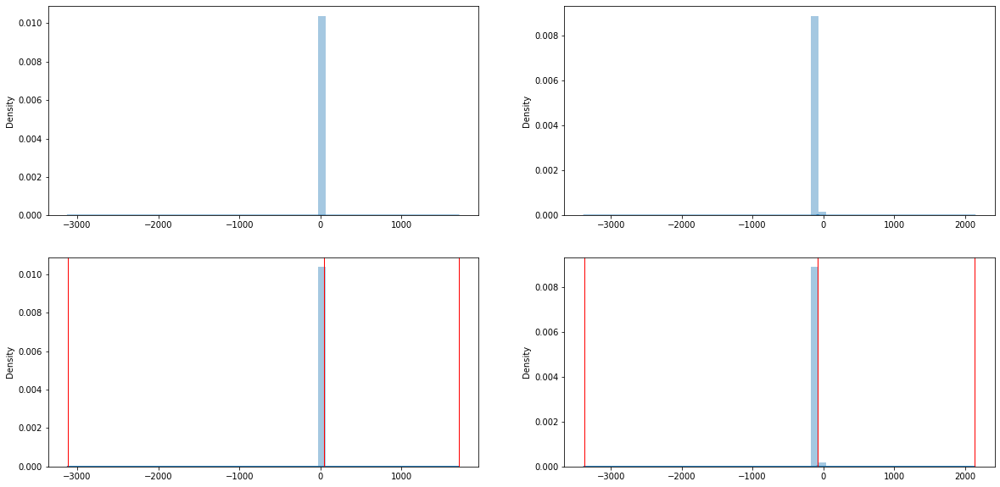

In [35]:
##Quantile Bucketization of latitude and longitude
# bins_lat = np.linspace(np.min([np.min(df['dropoff_latitude']),np.min(df['pickup_latitude'])]),
#             np.max([np.max(df['dropoff_latitude']),np.max(df['pickup_latitude'])]),
#             20)
bins_lat = pd.qcut(list(train_df_sample['dropoff_latitude'].values) + list(train_df_sample['pickup_latitude'].values), q=20, duplicates='drop', retbins=True)[1]

# bins_lon = np.linspace(np.min([np.min(df['dropoff_longitude']),np.min(df['pickup_longitude'])]),
#             np.max([np.max(df['dropoff_longitude']),np.max(df['pickup_longitude'])]),
#             20)
bins_lon = pd.qcut(list(train_df_sample['dropoff_longitude'].values) + list(train_df_sample['pickup_longitude'].values), q=20, duplicates='drop', retbins=True)[1]

#Plot all latitude values with bins
f, axes = plt.subplots(2, 2, figsize=(20, 10), sharex=False)
sns.distplot(list(train_df_sample['dropoff_latitude'].values) + list(train_df_sample['pickup_latitude'].values), ax=axes[0, 0])
sns.distplot(list(train_df_sample['dropoff_longitude'].values) + list(train_df_sample['pickup_longitude'].values), ax=axes[0, 1])

#Plot bins
sns.distplot(list(train_df_sample['dropoff_latitude'].values) + list(train_df_sample['pickup_latitude'].values), ax=axes[1, 0])
sns.distplot(list(train_df_sample['dropoff_longitude'].values) + list(train_df_sample['pickup_longitude'].values), ax=axes[1, 1])
for b_ in bins_lat:
  axes[1][0].axvline(b_, color='red', linewidth=1 )
for b_ in bins_lon:
  axes[1][1].axvline(b_, color='red', linewidth=1 )

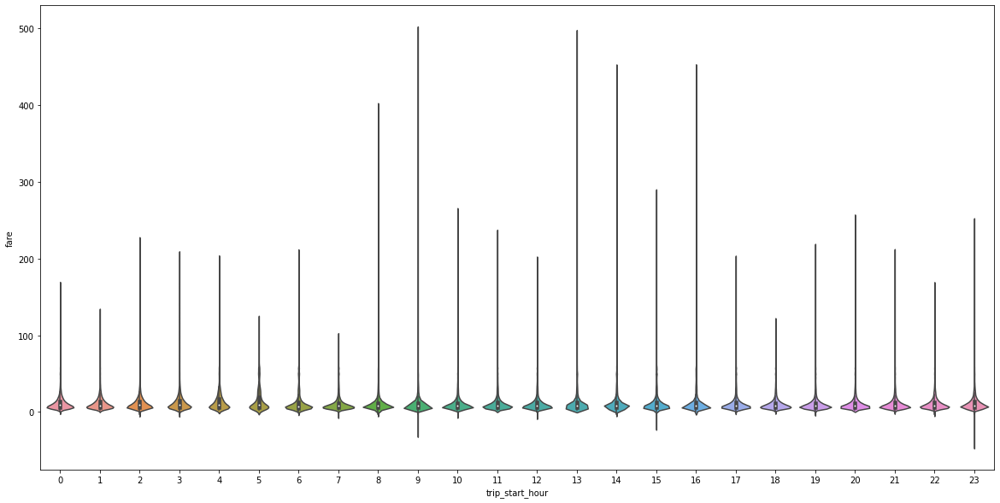

In [36]:
plt.figure(figsize=(20, 10))
sns.violinplot(x=train_df_sample['trip_start_hour'].astype(int), y=train_df_sample['fare'])

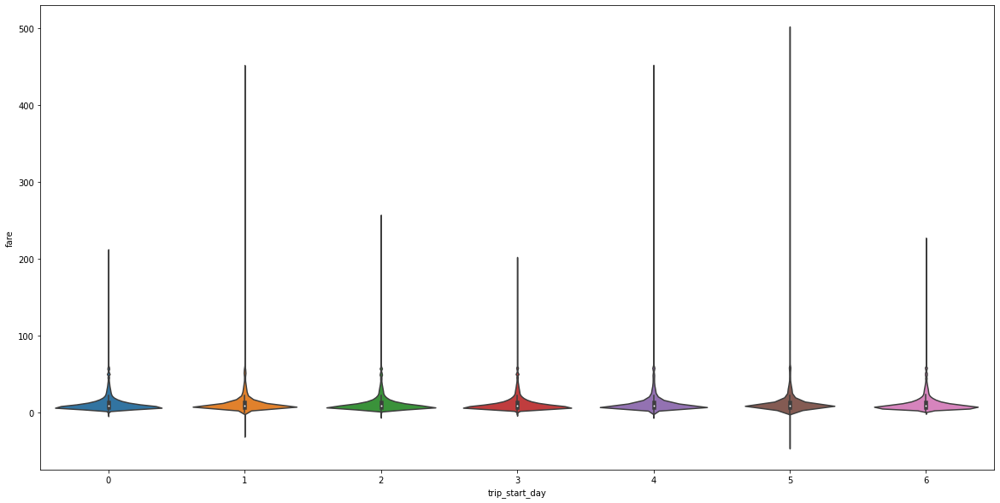

In [37]:
plt.figure(figsize=(20, 10))
sns.violinplot(x=train_df_sample['trip_start_day'].astype(int), y=train_df_sample['fare'])

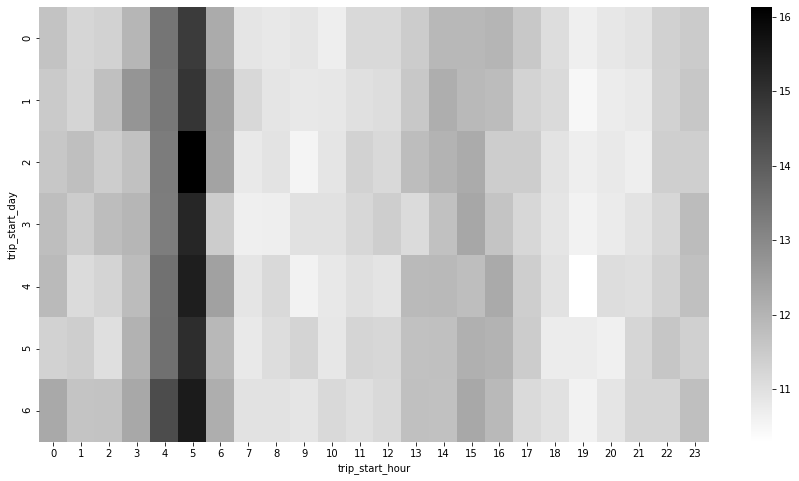

In [38]:
##Average trip fare( day & hour combined )
plt.figure(figsize=(15, 8))
cross = pd.crosstab(train_df_sample['trip_start_day'] , pd.to_numeric(train_df_sample['trip_start_hour']) , train_df_sample['fare'], aggfunc=np.average)

sns.heatmap(cross, annot=False, fmt='g', cmap='binary')

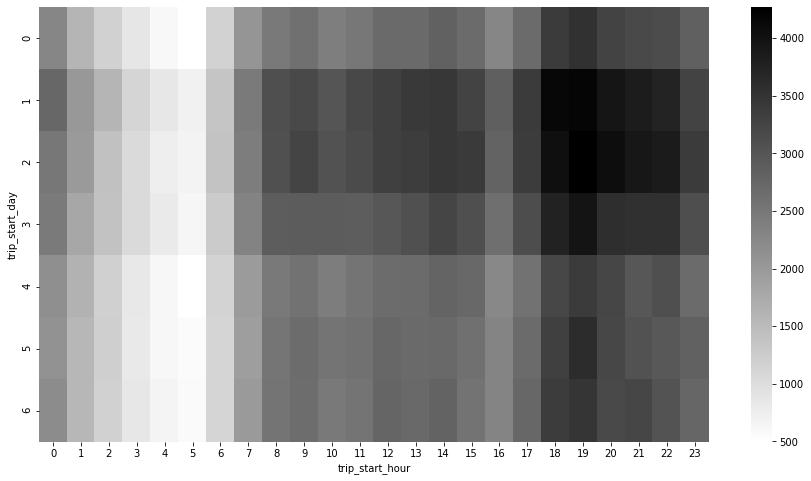

In [39]:
##Number of trips( day-hour wise )
plt.figure(figsize=(15, 8))
cross = pd.crosstab(train_df_sample['trip_start_day'] , pd.to_numeric(train_df_sample['trip_start_hour']) , train_df_sample.index , aggfunc='count')

sns.heatmap(cross, annot=False, fmt='g', cmap='binary')

##Feature Engineering

In [40]:
##Calculate Euclidean distance
from scipy.spatial import distance
def euclidean(row):
  # print(row)
  a = (row['pickup_latitude'], row['pickup_longitude'])
  b = (row['dropoff_latitude'], row['dropoff_longitude'])
  try:
    row['distance'] = distance.euclidean(a, b) * 100
  except ValueError:
    row['distance'] = None
  return row

train_df = train.apply(euclidean, axis=1)

train_df.head()

,fare,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_start_month,trip_start_day,trip_start_hour,distance
345179,9.3,-73.996578,40.742190,-73.965635,40.765307,08,0,23,3.862467
349830,3.7,-73.964780,40.764150,-73.958914,40.765547,07,5,15,0.603006
62334,25.3,-73.982052,40.758472,-73.957172,40.672608,06,6,03,8.939598
187780,5.3,-73.966578,40.761945,-73.975082,40.756235,08,0,08,1.024315
186560,8.0,-73.996455,40.732127,-73.984262,40.743159,07,1,21,1.644306


In [41]:
train_df = train_df.dropna()

In [42]:
train_df.isna().sum()

fare                 0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
trip_start_month     0
trip_start_day       0
trip_start_hour      0
distance             0
dtype: int64

In [43]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 419995 entries, 345179 to 136262
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   fare               419995 non-null  float64
 1   pickup_longitude   419995 non-null  float64
 2   pickup_latitude    419995 non-null  float64
 3   dropoff_longitude  419995 non-null  float64
 4   dropoff_latitude   419995 non-null  float64
 5   trip_start_month   419995 non-null  object 
 6   trip_start_day     419995 non-null  object 
 7   trip_start_hour    419995 non-null  object 
 8   distance           419995 non-null  float64
dtypes: float64(6), object(3)
memory usage: 32.0+ MB


In [44]:
#Calculate distance for testing data
#test_df = test_df.apply(euclidean, axis=1)
#test_df.head()

##Ingestion Pipeline

In [45]:
###############################
##Feature engineering functions
def feature_engg_features(features):
  #Add new features
  features['distance'] = ((features['pickup_latitude'] - features['dropoff_latitude'])**2 +  (features['pickup_longitude'] - features['dropoff_longitude'])**2)**0.5

  return(features)

#To be called from TF
def feature_engg(features, label):
  #Add new features
  features = feature_engg_features(features)

  return(features, label)

In [46]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 419995 entries, 345179 to 136262
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   fare               419995 non-null  float64
 1   pickup_longitude   419995 non-null  float64
 2   pickup_latitude    419995 non-null  float64
 3   dropoff_longitude  419995 non-null  float64
 4   dropoff_latitude   419995 non-null  float64
 5   trip_start_month   419995 non-null  object 
 6   trip_start_day     419995 non-null  object 
 7   trip_start_hour    419995 non-null  object 
 8   distance           419995 non-null  float64
dtypes: float64(6), object(3)
memory usage: 32.0+ MB


In [47]:
train_df_sample.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 419995 entries, 345179 to 136262
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   fare               419995 non-null  float64
 1   pickup_longitude   419995 non-null  float64
 2   pickup_latitude    419995 non-null  float64
 3   dropoff_longitude  419995 non-null  float64
 4   dropoff_latitude   419995 non-null  float64
 5   trip_start_month   419995 non-null  object 
 6   trip_start_day     419995 non-null  object 
 7   trip_start_hour    419995 non-null  object 
dtypes: float64(5), object(3)
memory usage: 48.8+ MB


In [48]:
###############################
###Data Input pipeline function

# Determine CSV, label, and key columns
#Columns in training sheet -> Can have extra columns too
CSV_COLUMNS = train_df.columns
LABEL_COLUMN = 'fare'

# Set default values for each CSV column( Including Y column )
DEFAULTS = [[0.0], [0.0],[0.0],[0.0],[0.0], ['1'], ['1'],['1']]

def make_input_fn(filename, mode, vnum_epochs = None, batch_size = 512):
    def _input_fn(v_test=False):     
        # Create list of files that match pattern
        file_list = tf.io.gfile.glob(filename)

        if mode == tf.estimator.ModeKeys.TRAIN:
            num_epochs = vnum_epochs # indefinitely
        else:
            num_epochs = 1 # end-of-input after this        
            
        # Create dataset from file list
        dataset = tf.compat.v1.data.experimental.make_csv_dataset(file_list,
                                                   batch_size=batch_size,
                                                   column_names=CSV_COLUMNS,
                                                   column_defaults=DEFAULTS,
                                                   label_name=LABEL_COLUMN,
                                                   num_epochs = num_epochs,
                                                   num_parallel_reads=30)
        
        dataset = dataset.prefetch(buffer_size = batch_size)

        #Feature engineering
        dataset = dataset.map(feature_engg)

        if mode == tf.estimator.ModeKeys.TRAIN:
            num_epochs = vnum_epochs # indefinitely
            dataset = dataset.shuffle(buffer_size = batch_size)
        else:
            num_epochs = 1 # end-of-input after this

        dataset = dataset.repeat(num_epochs)       
        
        #Begins - Uncomment for testing only -----------------------------------------------------<
        if v_test == True:
          print(next(dataset.__iter__()))
          
        #End - Uncomment for testing only -----------------------------------------------------<
        return dataset
    return _input_fn

In [49]:
train_df

,fare,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_start_month,trip_start_day,trip_start_hour,distance
345179,9.3,-73.996578,40.742190,-73.965635,40.765307,08,0,23,3.862467
349830,3.7,-73.964780,40.764150,-73.958914,40.765547,07,5,15,0.603006
62334,25.3,-73.982052,40.758472,-73.957172,40.672608,06,6,03,8.939598
187780,5.3,-73.966578,40.761945,-73.975082,40.756235,08,0,08,1.024315
186560,8.0,-73.996455,40.732127,-73.984262,40.743159,07,1,21,1.644306
...,...,...,...,...,...,...,...,...,...
252813,12.5,-73.992725,40.743053,-73.952360,40.784878,04,6,19,5.812628
123947,8.1,-73.978740,40.742753,-74.001803,40.738527,12,1,20,2.344698
666098,7.7,-73.989212,40.720312,-73.978921,40.741078,06,5,02,2.317610
31300,4.5,-73.984254,40.743378,-73.976783,40.739094,03,0,08,0.861211


In [50]:
#Test dataset read + Feat Engg function's - output's CSV + Feature engg columns
eval_file = "train1.csv"
fn_d = make_input_fn(filename = eval_file,
                    mode = tf.estimator.ModeKeys.EVAL,
                    # vnum_epochs = 1,
                    batch_size = 10)

fn_d(v_test=True)

(OrderedDict([('pickup_longitude', <tf.Tensor: shape=(10,), dtype=float32, numpy=
array([-73.98668 , -74.004166, -73.95321 , -73.86633 , -74.00261 ,
       -73.95143 , -73.96287 , -74.01017 , -73.970085, -73.98531 ],
      dtype=float32)>), ('pickup_latitude', <tf.Tensor: shape=(10,), dtype=float32, numpy=
array([40.725933, 40.758427, 40.771687, 40.771263, 40.734207, 40.77008 ,
       40.75783 , 40.71998 , 40.799286, 40.75966 ], dtype=float32)>), ('dropoff_longitude', <tf.Tensor: shape=(10,), dtype=float32, numpy=
array([-73.86486 , -73.99192 , -73.96325 , -74.013275, -73.99634 ,
       -73.99019 , -73.9827  , -73.99713 , -73.99475 , -73.91999 ],
      dtype=float32)>), ('dropoff_latitude', <tf.Tensor: shape=(10,), dtype=float32, numpy=
array([40.77042 , 40.750866, 40.756462, 40.704563, 40.736385, 40.75126 ,
       40.76613 , 40.725395, 40.749336, 40.77551 ], dtype=float32)>), ('trip_start_month', <tf.Tensor: shape=(10,), dtype=string, numpy=
array([b'05', b'11', b'08', b'01', b'03', b

<DatasetV1Adapter shapes: (OrderedDict([(pickup_longitude, (None,)), (pickup_latitude, (None,)), (dropoff_longitude, (None,)), (dropoff_latitude, (None,)), (trip_start_month, (None,)), (trip_start_day, (None,)), (trip_start_hour, (None,)), (distance, (None,))]), (None,)), types: (OrderedDict([(pickup_longitude, tf.float32), (pickup_latitude, tf.float32), (dropoff_longitude, tf.float32), (dropoff_latitude, tf.float32), (trip_start_month, tf.string), (trip_start_day, tf.string), (trip_start_hour, tf.string), (distance, tf.float32)]), tf.float32)>

In [51]:
# Define feature columns(Including feature engineered ones )
# These are the features which come from the TF Data pipeline
def create_feature_cols():
    #Keras format features
    k_month = tf.keras.Input(name='trip_start_month', shape=(1,), dtype=tf.string)
    k_hour  = tf.keras.Input(name='trip_start_hour', shape=(1,), dtype=tf.string)
    k_day  = tf.keras.Input(name='trip_start_day', shape=(1,), dtype=tf.string)
    k_picklat  = tf.keras.Input(name='pickup_latitude', shape=(1,), dtype=tf.float32)
    k_picklon  = tf.keras.Input(name='pickup_longitude', shape=(1,), dtype=tf.float32)
    k_droplat  = tf.keras.Input(name='dropoff_latitude', shape=(1,), dtype=tf.float32)
    k_droplon  = tf.keras.Input(name='dropoff_longitude', shape=(1,), dtype=tf.float32)
    k_distance  = tf.keras.Input(name='distance', shape=(1,), dtype=tf.float32)
    keras_dict_input = {'trip_start_month': k_month, 'trip_start_hour': k_hour, 'trip_start_day' : k_day,
                        'pickup_latitude': k_picklat, 'pickup_longitude': k_picklon,
                        'dropoff_latitude': k_droplat, 'dropoff_longitude': k_droplon, 'distance' : k_distance
                        }

    return({'K' : keras_dict_input})

create_feature_cols()

{'K': {'distance': <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'distance')>,
  'dropoff_latitude': <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'dropoff_latitude')>,
  'dropoff_longitude': <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'dropoff_longitude')>,
  'pickup_latitude': <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'pickup_latitude')>,
  'pickup_longitude': <KerasTensor: shape=(None, 1) dtype=float32 (created by layer 'pickup_longitude')>,
  'trip_start_day': <KerasTensor: shape=(None, 1) dtype=string (created by layer 'trip_start_day')>,
  'trip_start_hour': <KerasTensor: shape=(None, 1) dtype=string (created by layer 'trip_start_hour')>,
  'trip_start_month': <KerasTensor: shape=(None, 1) dtype=string (created by layer 'trip_start_month')>}}

##Create model

In [52]:
#Create model
params_default = {
    'lr' : 0.001,
    'beta_1' : 0.99,
    'beta_2' : 0.999,
    'epsilon' : 1e-08,
    'decay' : 0.01,
    'hidden_layers' : 1
}

##Feature Engineering
# def featengg_funcs(inp):
#     #Add all calculations, pass out as concatenate
#     vpatd_squared = inp[1] * inp[1]
#     vpatd_neg = -1 * inp[1]

#     return keras.layers.concatenate([vpatd_squared, vpatd_neg], axis = 1)

def create_keras_model(params, feature_cols):
    METRICS = [
            keras.metrics.RootMeanSquaredError(name='rmse')
    ]

    #Input layers
    input_feats = []
    for inp in feature_cols['K'].keys():
      input_feats.append(feature_cols['K'][inp])

    ##Input processing
    ##https://keras.io/examples/structured_data/structured_data_classification_from_scratch/
    ##https://github.com/tensorflow/community/blob/master/rfcs/20191212-keras-categorical-inputs.md

    ##Handle categorical attributes( One-hot encoding )
    cat_day = tf.keras.layers.experimental.preprocessing.StringLookup(vocabulary=['1','2','3','4','5','6','7'], mask_token=None)(feature_cols['K']['trip_start_day'])
    cat_day = tf.keras.layers.experimental.preprocessing.CategoryEncoding(max_tokens=7)(cat_day)

    cat_hour = tf.keras.layers.experimental.preprocessing.StringLookup(vocabulary=['1','2','3','4','5','6','7','8'
                                                                                      '9','10','11','12','13','14','15','16',
                                                                                      '17','18','19','20','21','22','23','0'
                                                                                      ], mask_token=None)(feature_cols['K']['trip_start_hour'])
    cat_hour = tf.keras.layers.experimental.preprocessing.CategoryEncoding(max_tokens=24)(cat_hour)

    cat_month = tf.keras.layers.experimental.preprocessing.StringLookup(vocabulary=['1','2','3','4','5','6','7','8'
                                                                                      '9','10','11','12'], mask_token=None)(feature_cols['K']['trip_start_month'])
    cat_month = tf.keras.layers.experimental.preprocessing.CategoryEncoding(max_tokens=12)(cat_month)

    # cat_company = tf.keras.layers.experimental.preprocessing.StringLookup(vocabulary=df['company'].unique(), mask_token=None)(feature_cols['K']['company'])
    # cat_company = tf.keras.layers.experimental.preprocessing.CategoryEncoding(max_tokens=len(df['company'].unique()))(cat_company)

    ##Binning
    bins_pickup_lat = tf.keras.layers.experimental.preprocessing.Discretization(bins = bins_lat)(feature_cols['K']['pickup_latitude'])
    cat_pickup_lat = tf.keras.layers.experimental.preprocessing.CategoryEncoding(len(bins_lat)+1)(bins_pickup_lat)

    bins_pickup_lon = tf.keras.layers.experimental.preprocessing.Discretization(bins = bins_lon)(feature_cols['K']['pickup_longitude'])
    cat_pickup_lon = tf.keras.layers.experimental.preprocessing.CategoryEncoding(len(bins_lon)+1)(bins_pickup_lon)

    bins_drop_lat = tf.keras.layers.experimental.preprocessing.Discretization(bins = bins_lat)(feature_cols['K']['dropoff_latitude'])
    cat_drop_lat = tf.keras.layers.experimental.preprocessing.CategoryEncoding(len(bins_lat)+1)(bins_drop_lat)

    bins_drop_lon = tf.keras.layers.experimental.preprocessing.Discretization(bins = bins_lon)(feature_cols['K']['dropoff_longitude'])
    cat_drop_lon = tf.keras.layers.experimental.preprocessing.CategoryEncoding(len(bins_lon)+1)(bins_drop_lon)

    ##Categorical cross
    cross_day_hour = tf.keras.layers.experimental.preprocessing.CategoryCrossing()([cat_day, cat_hour])
    hash_cross_day_hour = tf.keras.layers.experimental.preprocessing.Hashing(num_bins=24 * 7)(cross_day_hour)
    cat_cross_day_hour = tf.keras.layers.experimental.preprocessing.CategoryEncoding(max_tokens = 24* 7)(hash_cross_day_hour)

    cross_pick_lon_lat = tf.keras.layers.experimental.preprocessing.CategoryCrossing()([cat_pickup_lat, cat_pickup_lon])
    hash_cross_pick_lon_lat = tf.keras.layers.experimental.preprocessing.Hashing(num_bins=(len(bins_lat) + 1) ** 2)(cross_pick_lon_lat)

    cross_drop_lon_lat = tf.keras.layers.experimental.preprocessing.CategoryCrossing()([cat_drop_lat, cat_drop_lon])
    hash_cross_drop_lon_lat = tf.keras.layers.experimental.preprocessing.Hashing(num_bins=(len(bins_lat) + 1) ** 2)(cross_drop_lon_lat)

    # Cross to embedding
    embed_cross_pick_lon_lat = tf.keras.layers.Embedding(((len(bins_lat) + 1) ** 2), 4)(hash_cross_pick_lon_lat)
    embed_cross_pick_lon_lat = tf.reduce_sum(embed_cross_pick_lon_lat, axis=-2)

    embed_cross_drop_lon_lat = tf.keras.layers.Embedding(((len(bins_lat) + 1) ** 2), 4)(hash_cross_drop_lon_lat)
    embed_cross_drop_lon_lat = tf.reduce_sum(embed_cross_drop_lon_lat, axis=-2)

    # Also pass time attributes as Deep signal( Cast to integer )
    int_trip_start_day = tf.strings.to_number(feature_cols['K']['trip_start_day'], tf.float32)
    int_trip_start_hour = tf.strings.to_number(feature_cols['K']['trip_start_hour'], tf.float32)
    int_trip_start_month = tf.strings.to_number(feature_cols['K']['trip_start_month'], tf.float32)

    #Add feature engineered columns - LAMBDA layer

    ###Create MODEL
    ####Concatenate all features( Numerical input )
    x_input_numeric = tf.keras.layers.concatenate([
                    feature_cols['K']['pickup_latitude'], feature_cols['K']['pickup_longitude'],
                    feature_cols['K']['dropoff_latitude'], feature_cols['K']['dropoff_longitude'],
                    feature_cols['K']['distance'], embed_cross_pick_lon_lat, embed_cross_drop_lon_lat,
                    int_trip_start_day, int_trip_start_hour, int_trip_start_month
                    ])

    #DEEP - This Dense layer connects to input layer - Numeric Data
    x_numeric = tf.keras.layers.Dense(32, activation='relu', kernel_initializer="he_uniform")(x_input_numeric)
    x_numeric = tf.keras.layers.BatchNormalization()(x_numeric)

    ####Concatenate all Categorical features( Categorical converted )
    x_input_categ = tf.keras.layers.concatenate([
                    cat_month, cat_cross_day_hour, cat_pickup_lat, cat_pickup_lon,
                    cat_drop_lat, cat_drop_lon
                    ])
    
    #WIDE - This Dense layer connects to input layer - Categorical Data
    x_categ = tf.keras.layers.Dense(32, activation='relu', kernel_initializer="he_uniform")(x_input_categ)

    ####Concatenate both Wide and Deep layers
    x = tf.keras.layers.concatenate([x_categ, x_numeric])

    for l_ in range(params['hidden_layers']):
        x = tf.keras.layers.Dense(32, activation='relu', kernel_initializer="he_uniform",
                                  activity_regularizer=tf.keras.regularizers.l2(0.00001))(x)
        x = tf.keras.layers.BatchNormalization()(x)

    #Final Layer
    out = tf.keras.layers.Dense(1, activation='relu')(x)
    model = tf.keras.Model(input_feats, out)

    #Set optimizer
    opt = tf.keras.optimizers.Adam(lr= params['lr'], beta_1=params['beta_1'], 
                                        beta_2=params['beta_2'], epsilon=params['epsilon'])

    #Compile model
    model.compile(loss='mean_squared_error',  optimizer=opt, metrics = METRICS)

    #Print Summary
    print(model.summary())
    return model

In [53]:
def keras_train_and_evaluate(model, train_dataset, validation_dataset, epochs=100):
  #Add callbacks
  reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                                patience=5, min_lr=0.00001, verbose = 1)
  
  tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir="./logs")

  #Train and Evaluate
  out = model.fit(train_dataset, 
                  validation_data = validation_dataset,
                  epochs=epochs,
                  # validation_steps = 3,   ###Keep this none for running evaluation on full EVAL data every epoch
                  steps_per_epoch = 100,   ###Has to be passed - Cant help it :) [ Number of batches per epoch ]
                  callbacks=[reduce_lr, #modelsave_callback, #tensorboard_callback, 
                             keras.callbacks.EarlyStopping(patience=20, restore_best_weights=True, verbose=True)]
                  )

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
pickup_latitude (InputLayer)    [(None, 1)]          0                                            
__________________________________________________________________________________________________
pickup_longitude (InputLayer)   [(None, 1)]          0                                            
__________________________________________________________________________________________________
dropoff_latitude (InputLayer)   [(None, 1)]          0                                            
__________________________________________________________________________________________________
dropoff_longitude (InputLayer)  [(None, 1)]          0                                            
______________________________________________________________________________________________

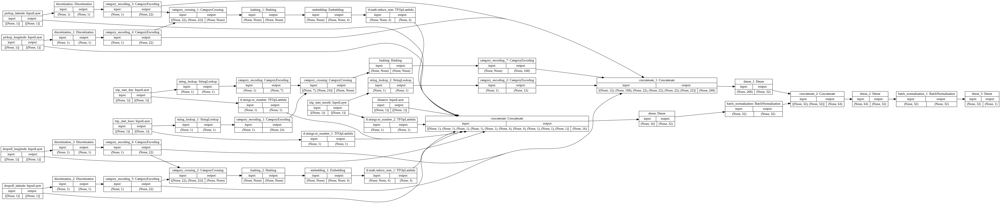

In [54]:
#Create dataset input functions
train_dataset = make_input_fn(filename = 'train1.csv',
                    mode = tf.estimator.ModeKeys.TRAIN,
                    # vnum_epochs = epochs,
                    batch_size = 128)()

validation_dataset = make_input_fn(filename = 'eval.csv',
                    mode = tf.estimator.ModeKeys.EVAL,
                    # vnum_epochs = 1,
                    batch_size = 512)()

m_ = create_keras_model(params = params_default, feature_cols = create_feature_cols())
tf.keras.utils.plot_model(m_, show_shapes=True, rankdir="LR")

In [55]:
!rm -rf "./logs"
# %tensorboard --logdir "./logs"

keras_train_and_evaluate(m_, train_dataset, validation_dataset, 50) #set to 50 for final run

Epoch 1/50
100/100 [==============================] - 186s 2s/step - loss: 219.0425 - rmse: 14.7880 - val_loss: 205.0549 - val_rmse: 14.3197
Epoch 2/50
100/100 [==============================] - 182s 2s/step - loss: 148.8247 - rmse: 12.1982 - val_loss: 123.7709 - val_rmse: 11.1252
Epoch 3/50
100/100 [==============================] - 182s 2s/step - loss: 127.7240 - rmse: 11.2768 - val_loss: 98.9240 - val_rmse: 9.9460
Epoch 4/50
100/100 [==============================] - 182s 2s/step - loss: 91.0500 - rmse: 9.5318 - val_loss: 90.3740 - val_rmse: 9.5065
Epoch 5/50
100/100 [==============================] - 183s 2s/step - loss: 77.5030 - rmse: 8.7909 - val_loss: 105.5239 - val_rmse: 10.2725
Epoch 6/50
100/100 [==============================] - 183s 2s/step - loss: 55.2576 - rmse: 7.4303 - val_loss: 146.0366 - val_rmse: 12.0845
Epoch 7/50
100/100 [==============================] - 183s 2s/step - loss: 63.4255 - rmse: 7.9219 - val_loss: 66.5831 - val_rmse: 8.1598
Epoch 8/50
100/100 [=======

##Export model

In [56]:
# ## Prediction directly using model's instance
# ## BUT HERE ALL FEATURES HAVE TO BE PASSED, EVEN THE Calculated ones
data = tf.data.Dataset.from_tensor_slices({'dropoff_latitude': [[41.920452]],
                         'dropoff_longitude': [[-87.679955]],
                         'pickup_latitude': [[41.952823]],
                         'pickup_longitude': [[-87.653244]],
                         'trip_start_day': [["1"]],
                         'trip_start_hour': [["5"]],
                         'trip_start_month': [["6"]],
                         'distance':[[0.04196861]]})

m_.predict(data)

array([[52.124542]], dtype=float32)

In [57]:
@tf.function
def serving(dropoff_latitude, dropoff_longitude, pickup_latitude, pickup_longitude, trip_start_day, trip_start_hour, trip_start_month):
    ##Feature engineering( calculate distance )
    distance = tf.cast( tf.sqrt((tf.abs(dropoff_latitude - pickup_latitude))**2 + (tf.abs(dropoff_longitude - pickup_longitude))**2), tf.float32)

    payload = {
        'dropoff_latitude': dropoff_latitude,
        'dropoff_longitude': dropoff_longitude,
        'pickup_latitude': pickup_latitude,
        'pickup_longitude': pickup_longitude,
        'trip_start_day': trip_start_day,
        'trip_start_hour': trip_start_hour,
        'trip_start_month': trip_start_month,
        'distance': distance
    }
    
    ## Predict
    ##IF THERE IS AN ERROR IN NUMBER OF PARAMS PASSED HERE OR DATA TYPE THEN IT GIVES ERROR, "COULDN'T COMPUTE OUTPUT TENSOR"
    predictions = m_(payload)
    return predictions

serving = serving.get_concrete_function(trip_start_day=tf.TensorSpec([None,], dtype= tf.string, name='trip_start_day'), 
                                        trip_start_hour=tf.TensorSpec([None,], dtype= tf.string, name='trip_start_hour'),
                                        trip_start_month=tf.TensorSpec([None], dtype= tf.string, name='trip_start_month'), 
                                        dropoff_latitude=tf.TensorSpec([None,], dtype= tf.float32, name='dropoff_latitude'),
                                        dropoff_longitude=tf.TensorSpec([None,], dtype= tf.float32, name='dropoff_longitude'), 
                                        pickup_latitude=tf.TensorSpec([None,], dtype= tf.float32, name='pickup_latitude'),
                                        pickup_longitude=tf.TensorSpec([None,], dtype= tf.float32, name='pickup_longitude')
                                        )

version = "1"  #{'serving_default': call_output}
tf.saved_model.save(
    m_,
    "./exported_model/" + version,
    signatures=serving
) 

# tf.saved_model.save(
#     m_,
#     "./exported_model/" + version,
#     signatures={'serving_default': serving}
# ) 

INFO:tensorflow:Assets written to: ./exported_model/1/assets


In [58]:
# !zip -r /content/model.zip /content/exported_model/1
!tar -cvf /content/model.tar /content/exported_model/1/

tar: Removing leading `/' from member names
/content/exported_model/1/
/content/exported_model/1/variables/
/content/exported_model/1/variables/variables.index
/content/exported_model/1/variables/variables.data-00000-of-00001
/content/exported_model/1/saved_model.pb
/content/exported_model/1/assets/


In [59]:
##Check signature
!saved_model_cli show --dir "./exported_model/1" --all


MetaGraphDef with tag-set: 'serve' contains the following SignatureDefs:

signature_def['__saved_model_init_op']:
  The given SavedModel SignatureDef contains the following input(s):
  The given SavedModel SignatureDef contains the following output(s):
    outputs['__saved_model_init_op'] tensor_info:
        dtype: DT_INVALID
        shape: unknown_rank
        name: NoOp
  Method name is: 

signature_def['serving_default']:
  The given SavedModel SignatureDef contains the following input(s):
    inputs['dropoff_latitude'] tensor_info:
        dtype: DT_FLOAT
        shape: (-1)
        name: serving_default_dropoff_latitude:0
    inputs['dropoff_longitude'] tensor_info:
        dtype: DT_FLOAT
        shape: (-1)
        name: serving_default_dropoff_longitude:0
    inputs['pickup_latitude'] tensor_info:
        dtype: DT_FLOAT
        shape: (-1)
        name: serving_default_pickup_latitude:0
    inputs['pickup_longitude'] tensor_info:
        dtype: DT_FLOAT
        shape: (-1)
 

In [60]:
#LOCAL: Predict using Keras prediction function
saved_mod = tf.saved_model.load("./exported_model/" + version)

#Get prediction function from serving
f = saved_mod.signatures['serving_default']

#Run prediction function from serving
f(dropoff_latitude=tf.convert_to_tensor([41.920452]), dropoff_longitude = tf.convert_to_tensor([-87.679955]), pickup_latitude = tf.convert_to_tensor([41.952823]), 
  pickup_longitude =tf.convert_to_tensor([-87.653244]), trip_start_day=tf.convert_to_tensor(["1"]), trip_start_hour=tf.convert_to_tensor(["5"]),
  trip_start_month=tf.convert_to_tensor(["6"]))

{'output_0': <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[52.124542]], dtype=float32)>}

In [61]:
###Install TF Model server

# This is the same as you would do from your command line, but without the [arch=amd64], and no sudo
# You would instead do:
# echo "deb [arch=amd64] http://storage.googleapis.com/tensorflow-serving-apt stable tensorflow-model-server tensorflow-model-server-universal" | sudo tee /etc/apt/sources.list.d/tensorflow-serving.list && \
# curl https://storage.googleapis.com/tensorflow-serving-apt/tensorflow-serving.release.pub.gpg | sudo apt-key add -

!apt-get remove tensorflow-model-server
!echo "deb http://storage.googleapis.com/tensorflow-serving-apt stable tensorflow-model-server tensorflow-model-server-universal" | tee /etc/apt/sources.list.d/tensorflow-serving.list && \
curl https://storage.googleapis.com/tensorflow-serving-apt/tensorflow-serving.release.pub.gpg | apt-key add -
!apt update

!apt-get install tensorflow-model-server

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following packages will be REMOVED:
  tensorflow-model-server
0 upgraded, 0 newly installed, 1 to remove and 40 not upgraded.
After this operation, 0 B of additional disk space will be used.
(Reading database ... 160691 files and directories currently installed.)
Removing tensorflow-model-server (2.5.0) ...
deb http://storage.googleapis.com/tensorflow-serving-apt stable tensorflow-model-server tensorflow-model-server-universal
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  2943  100  2943    0     0  39240      0 --:--:-- --:--:-- --:--:-- 39240
OK
Hit:1 http://storage.googleapis.com/tensorflow-serving-apt stable InRelease
Hit:2 https://clou

In [62]:
###Start Tensorflow server
# %%bash --bg 
# export TF_CPP_MIN_VLOG_LEVEL=0

%%bash --bg 
nohup tensorflow_model_server \
  --rest_api_port=8505 \
  --model_name=model \
  --model_base_path="/content/exported_model" >server.log 2>&1

Starting job # 0 in a separate thread.


In [63]:
!tail server.log

2021-04-26 12:11:19.285170: I tensorflow_serving/model_servers/server.cc:89] Building single TensorFlow model file config:  model_name: model model_base_path: /content/exported_model
2021-04-26 12:11:19.285541: I tensorflow_serving/model_servers/server_core.cc:465] Adding/updating models.
2021-04-26 12:11:19.285584: I tensorflow_serving/model_servers/server_core.cc:591]  (Re-)adding model: model


In [64]:
import json
import requests

#Create payload
data_py = {"instances":[{'dropoff_latitude': [41.920452],
                         'dropoff_longitude': [-87.679955],
                         'pickup_latitude': [41.952823],
                         'pickup_longitude': [-87.653244],
                         'trip_start_day': ["1"],
                         'trip_start_hour': ["5"],
                         'trip_start_month': ["6"]}]}

data = json.dumps(data_py)
print("payload: ", data)

#Run request on TMS
headers = {"content-type": "application/json"}
json_response = requests.post('http://localhost:8505/v1/models/model:predict', data=data, headers=headers)
json_response.text

payload:  {"instances": [{"dropoff_latitude": [41.920452], "dropoff_longitude": [-87.679955], "pickup_latitude": [41.952823], "pickup_longitude": [-87.653244], "trip_start_day": ["1"], "trip_start_hour": ["5"], "trip_start_month": ["6"]}]}


'{\n    "error": "Shape must be at most rank 2 but is rank 3\\n\\t [[{{node model/category_encoding/bincount/DenseBincount}}]]"\n}'